In [1]:
import pandas as pd
import numpy as np
import yaml
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
from scipy.fft import fft
from scipy.stats import boxcox
from scipy.special import inv_boxcox
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder, MinMaxScaler, PowerTransformer, RobustScaler
from sklearn.linear_model import LinearRegression
import openpyxl
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, recall_score,precision_score, f1_score, mean_squared_error
import xgboost as xgb
import optuna
import talib
import json
import pickle
import torch
import os
import logging
from scipy.stats.mstats import winsorize
from plotly.subplots import make_subplots
import seaborn as sns
from imblearn.over_sampling import SMOTEN
import smogn
import warnings
from datetime import datetime, timedelta

In [8]:
print(torch.backends.mps.is_available())

True


In [2]:
def load_yaml(file):
    import yaml
    with open(file, 'r') as f:
        config = yaml.safe_load(f)
    return config
    



In [3]:
config = load_yaml('../config_xgRegPower.yaml')

In [4]:
for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)

log_dir = "logs"
os.makedirs(log_dir, exist_ok=True)
log_file = "logstraining_logs_xgRegPower_v2_1minute.txt"
log_file_path = os.path.join(log_dir, log_file)
print(log_file_path)
logging.basicConfig(
    filename=log_file_path,
    level=logging.INFO,
    format="%(asctime)s - %(levelname)s - %(message)s",
    datefmt="%Y-%m-%d %H:%M:%S"
)

logging.info("Logging started")

logs\logstraining_logs_xgRegPower_v2_1minute.txt


In [5]:
all_trading_data_dfs = []
sheet_names = ['1minData1-6-2022', '1minData1-12-2023', '1minData1-22-2024']
for sheet in sheet_names:
    temp_df = pd.read_excel(config['all_data_excel_path'], sheet_name=sheet)
    all_trading_data_dfs.append(temp_df)
all_trading_data = pd.concat(all_trading_data_dfs, ignore_index=True)

# Load 5 min data
all_trading_data['Date'] = pd.to_datetime(all_trading_data['Date'])

In [6]:
##### Set the Date Start and End for the filtering of trading data
train_start_date = pd.to_datetime('2023-01-01')
train_end_date = pd.to_datetime('2023-12-31')
trading_data_raw = all_trading_data[(all_trading_data['Date'] >= train_start_date) & (all_trading_data['Date'] <= train_end_date)]
trading_data_raw = trading_data_raw.reset_index(drop=True)
trading_data_raw.drop(columns=['Symbol'], inplace=True)
trading_data_raw.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97532 entries, 0 to 97531
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    97532 non-null  datetime64[ns]
 1   Open    97532 non-null  float64       
 2   High    97532 non-null  float64       
 3   Low     97532 non-null  float64       
 4   Close   97532 non-null  float64       
 5   Volume  97532 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(1)
memory usage: 4.5 MB


In [7]:
fourier_lookback_window = config['fourier_lookback_window']
fourier_n_components = config['fourier_n_components']
m_bars = config['m_future']

In [8]:
def calculate_bollinger_bands(data, window_size, num_std_dev):
    rolling_mean = data['Close'].rolling(window=window_size).mean()
    rolling_std = data['Close'].rolling(window=window_size).std()
    data['BOLLBU'] = rolling_mean + (rolling_std * num_std_dev)
    data['BOLLBM'] = rolling_mean
    data['BOLLBL'] = rolling_mean - (rolling_std * num_std_dev)
    
    return data

def calculate_donchn_bands(data, window_size):
    data['DONCH_U'] = data['High'].rolling(window=window_size).max()
    data['DONCH_L'] = data['Low'].rolling(window=window_size).min()
    
    return data
    
def calculate_tchr(data):
    period = config['tchr_period']
    retracement = config['tchr_retracement']
    adj = config['tchr_adj']
    range = config['tchr_range']

    if range == 'highlow':
        data['TCHR_U'] = talib.MAX(data['High'], timeperiod=period) + adj
        data['TCHR_L'] = talib.MIN(data['Low'], timeperiod=period) - adj
    elif range == 'close':
        data['TCHR_U'] = talib.MAX(data['Close'], timeperiod=period) + adj
        data['TCHR_L'] = talib.MIN(data['Close'], timeperiod=period) - adj
    
    #calculate retracement
    if retracement == "long":
        data['TCHR'] = (data['Close'] - data['TCHR_L']) / (data['TCHR_U'] - data['TCHR_L'])
    elif retracement == "short":
        data['TCHR'] = (data['TCHR_U'] - data['Close']) / (data['TCHR_U'] - data['TCHR_L'])
    
    return data
    
def calculate_adwm(data):
    period = config['adwm_period']
    data['Previous_Close']= data['Close'].shift(1)
    data['TRH'] = data[['High', 'Previous_Close']].max(axis=1)
    data['TRL'] = data[['Low', 'Previous_Close']].min(axis=1)

    data['ADWM_AD'] = 0.0
    data.loc[data['Close'] > data['Previous_Close'], 'ADWM_AD'] = (data['Close'] - data['TRL'])
    data.loc[data['Close'] < data['Previous_Close'], 'ADWM_AD'] = (data['Close'] - data['TRH'])

    data['ADWM'] = data['ADWM_AD']

    data['ADWMMA'] = data['ADWM'].rolling(window=period).mean()

    return data

def calculate_si(row, prev_row, limit):
    if pd.isna(prev_row['Close']):
        return 0
    c = row['Close']
    c_prev = prev_row['Close']
    o = row['Open']
    o_prev = prev_row['Open']
    return (50 * ((c - c_prev) + (0.5 * (c - o)) + (0.25 * (c_prev - o_prev))) / limit)

def calculate_WASI(data):
    wasi_limit = config['wasi_limit']
    data['SI'] = data.apply(lambda row: calculate_si(row, data.shift(1).loc[row.name], wasi_limit), axis=1)
    data['WASI'] = data['SI']
    return data

def calculate_ATR(data):
    atr_period = config['atr_period']
    atr_ma = config['atr_ma']
    data['ATR'] = talib.ATR(data['High'], data['Low'], data['Close'], timeperiod=atr_period)
    data['ADJATR'] = talib.SMA(data['ATR'], timeperiod=atr_ma)
    return data


def compute_volatility_momentum(df, price_col='Close', vol_window=14, mom_window=10):
    """
    Computes rolling volatility and momentum for a given price column.

    Parameters:
        df (pd.DataFrame): DataFrame containing historical price data.
        price_col (str): Column name of the closing price.
        vol_window (int): Window size for rolling volatility calculation.
        mom_window (int): Window size for momentum calculation.

    Returns:
        pd.DataFrame: DataFrame with added 'Volatility' and 'Momentum' features.
    """

    # Ensure price column exists
    if price_col not in df.columns:
        raise ValueError(f"Column '{price_col}' not found in DataFrame")

    # 🔹 Compute Log Returns (for better volatility calculation)
    df['Log_Returns'] = np.log(df[price_col] / df[price_col].shift(1))

    # 🔹 Compute Rolling Volatility (Standard Deviation of Log Returns)
    df['Volatility'] = df['Log_Returns'].rolling(window=vol_window).std()

    # 🔹 Compute Momentum (Rate of Change in Price)
    df['Momentum'] = df[price_col].pct_change(periods=mom_window) * 100

    # 🔹 Drop NaN values from rolling computations
    #df.dropna(inplace=True)

    return df


def compute_fourier_df(value_series, n_components=10):
    fft_result = np.fft.fft(value_series)
    real = fft_result.real[:n_components]
    imag = fft_result.imag[:n_components]
    mag = np.abs(fft_result)[:n_components]

    return real, imag, mag

def get_fourier_columns():
    return [f'fourier_real_{j+2}' for j in range(fourier_n_components-1)] + [f'fourier_imag_{j+2}' for j in range(fourier_n_components-1)] + [f'fourier_mag_{j+2}' for j in range(fourier_n_components-1)]   

def transform_features(df):
    close_diff_features = config['Close_Diff_Features'].split(',')
    df[close_diff_features] = df[close_diff_features].sub(df['Close'], axis=0).div(df['Close'], axis=0)
    return df

def get_all_training_features():
    training_features = config['training_features'].split(',')
    fourier_cols = get_fourier_columns()
    return training_features + fourier_cols

def normalize_timegaps(df, time_gap_threshold=300):
    df = df.copy()
    features = ['Open', 'High', 'Low', 'Close']
    df['time_delta'] = df['Date'].diff().dt.total_seconds()
    df['time_delta'] = df['time_delta'].fillna(df['time_delta'].median())
    df['time_gap_flag'] = df['time_delta'] > time_gap_threshold
    gap_indices = df.index[df['time_gap_flag']].tolist()
    for p in gap_indices:
        if p > 0: # ensure p-1 exist
            jump_value = df.loc[p, 'Close'] - df.loc[p-1, 'Close']
            df.loc[:p-1, features] += jump_value
    return df

In [9]:
def add_new_features_df(data):
    fourier_lookback_window = config['fourier_lookback_window']
    fourier_n_components = config['fourier_n_components']

    #data['Date'] = pd.to_datetime(data['Date'])
    #print(f"bolband period : {config['bolband_period']}")
    bolband_period = config['bolband_period']
    bolband_width = config['bolband_width']
    upper, middle, lower = talib.BBANDS(data['Close'], timeperiod=bolband_period, nbdevup=bolband_width, nbdevdn=bolband_width, matype=0)
    data['BOLLBU'] = upper
    data['BOLLBM'] = middle
    data['BOLLBL'] = lower
    #data = calculate_bollinger_bands(data, int(config['bolband_period']), int(config['bolband_width']))

    # Calculate DONCHN Bands
    donchn_period = config['donchn_period']
    data['DONUP'] = talib.MAX(data['High'], timeperiod=donchn_period)

    data['DONLOW'] = talib.MIN(data['Low'], timeperiod=donchn_period)

    data['DONMID'] = (data['DONLOW'] + data['DONUP']) / 2

    data['MA20'] = talib.SMA(data['Close'], timeperiod=20)

    data['MA50'] = talib.SMA(data['Close'], timeperiod=50)

    data['MA100'] = talib.SMA(data['Close'], timeperiod=100)

    data['EMA20'] = talib.EMA(data['Close'], timeperiod=20)

    # Calculate the pivot points
    data['PVPT'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['PVPTR1'] = (2 * data['PVPT']) - data['Low']

    data['PVPTR2'] = data['PVPT'] + data['High'] - data['Low']

    data['PVPTR3'] = data['High'] + 2 * (data['PVPT'] - data['Low'])

    data['PVPTS1'] = (2 * data['PVPT']) - data['High']

    data['PVPTS2'] = data['PVPT'] - (data['High'] - data['Low'])

    data['PVPTS3'] = data['Low'] - 2 * (data['High'] - data['PVPT'])

    data = calculate_tchr(data)

    data = calculate_adwm(data)

    data = calculate_WASI(data)

    volume_ma_period = config['volume_ma_period']

    data['VOLMA'] = talib.SMA(data['Volume'], timeperiod=volume_ma_period)

    data = calculate_ATR(data)

    data['DayofWeek'] = data['Date'].dt.dayofweek

    data['DayofWeek'] = data['DayofWeek'].astype('category')

    data = compute_volatility_momentum(data, price_col='Close', vol_window=config['volatility_period'], mom_window=config['momentum_period'])

    # Add fourier columns to the df
    for i in range(fourier_n_components):
        data[f'fourier_real_{i+1}'] = np.nan
        data[f'fourier_imag_{i+1}'] = np.nan
        data[f'fourier_mag_{i+1}'] = np.nan

    features = []
    epsilon = 1e-5
    #print(f"fourier window - 1 : {fourier_lookback_window - 1}")
    for i in range(len(data)):
        if i >= fourier_lookback_window - 1:
            #print("entered point 1")
            close_window = data['Close'].iloc[i - fourier_lookback_window + 1: i + 1].values
            real, imag, mag = compute_fourier_df(close_window, n_components=fourier_n_components)

            for j in range(fourier_n_components):
                data.iloc[i, data.columns.get_loc(f'fourier_real_{j+1}')] = real[j]
                data.iloc[i, data.columns.get_loc(f'fourier_imag_{j+1}')] = imag[j]
                data.iloc[i, data.columns.get_loc(f'fourier_mag_{j+1}')] = mag[j]
                #print(data.loc[i, 'Date'])
    


    # Add the time of day feature to the trading data

    # Define max time of day in minutes
    MAX_TIME_MINUTES = 1440
    data['Minutes_Passed'] = (data['Date'].dt.hour* 60) + data['Date'].dt.minute
    data['TimeOfDay_Group'] = (data['Minutes_Passed'] // 5).astype('int')
    data['Sine_TimeOfDay'] = np.sin(2 * np.pi * data['TimeOfDay_Group'] / MAX_TIME_MINUTES)
    data['Cosine_TimeOfDay'] = np.cos(2 * np.pi * data['TimeOfDay_Group'] / MAX_TIME_MINUTES)
    data['Take_Profit_Level'] = (data['Close'] * config['atr_multiplier'] * data['ADJATR'])
    data['time_delta'] = data['Date'].diff().dt.total_seconds()
    data['time_delta'].fillna(data['time_delta'].median(), inplace=True)
    #print("Feature df info : ")
    #print(data.info())

    #print(f"Last row after adding features : ")
    #print(data.tail())
    return data


In [10]:
trading_data_time_normalized = normalize_timegaps(trading_data_raw)

In [12]:
toplot_df = trading_data_time_normalized

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                    vertical_spacing=0.1,
                    subplot_titles=("CandleStick Chart Norm", "CandleStick Chart"))
fig.add_trace(
    go.Candlestick(
        x=toplot_df['Date'], 
        open=toplot_df['Open'], 
        high=toplot_df['High'], 
        low=toplot_df['Low'], 
        close=toplot_df['Close'],
        name='OHLC Norm'
        ), row=1, col=1
)

fig.add_trace(
    go.Candlestick(
        x=trading_data_raw['Date'], 
        open=trading_data_raw['Open'], 
        high=trading_data_raw['High'], 
        low=trading_data_raw['Low'], 
        close=trading_data_raw['Close'],
        name='OHLC'
        ), row=2,col=1
)

fig.update_layout(
    title='CandleStick chart of time normalized',
    xaxis=dict(type="date", 
               rangebreaks=[
                   dict(bounds=["sat", "mon"]),
                   dict(bounds=[16,9.5], pattern='hour')
               ]              
            ),
    xaxis_rangeslider_visible=False,
    height=600,
    hovermode='x unified'
)



fig.update_xaxes(matches='x')

fig.show()

In [13]:

def calculate_label(data):

# Define the threshold for buy and sell signals
    
    buy_powers = []
    sell_powers = []
    n=config['bars_no_to_wait']
    for i in range(len(data)):
        current_close = data.loc[i, "Close"]

        future_closes = data.loc[i+1: i+n+1, "Close"].values

        if len(future_closes) == 0:
            buy_powers.append(0)
            sell_powers.append(0)
            continue
        future_close_max = max(future_closes) 
        future_close_min = min(future_closes)
        max_high = future_close_max - current_close
        min_high = current_close - future_close_min
        max_high_idx = list(future_closes).index( future_close_max)
        min_high_idx = list(future_closes).index( future_close_min)

        if max_high_idx == (len(future_closes) - 1): #when max value is at the last of window
            buy_retr_penalty = 0
        else:
            buy_retr_penalty = future_close_max - min(future_closes[max_high_idx+1:])
        max_down_below = max(0, current_close - future_close_min)
        penalty_buy = buy_retr_penalty + max_down_below
        buy_power = max(0, max_high - penalty_buy)

        if min_high_idx == (len(future_closes) - 1): 
            sell_retr_penalty = 0
        else:
            sell_retr_penalty = max(future_closes[min_high_idx+1:]) - future_close_min
        max_up_above = max(0, future_close_max - current_close)
        penalty_sell = sell_retr_penalty + max_up_above
        sell_power = max(0, min_high - penalty_sell)

        buy_powers.append(buy_power)
        sell_powers.append(sell_power)

    data['BuyPower'] = buy_powers
    data['SellPower'] = sell_powers
        

    return data

In [ ]:
trading_data_with_features = add_new_features_df(trading_data_time_normalized.copy())

In [20]:
trading_data_with_power = calculate_label(trading_data_time_normalized)
trading_data_with_power.dropna(inplace=True)

In [21]:
trading_data_with_power[['BuyPower']].describe()

,BuyPower
count,97532.000000
mean,0.141181
std,0.294040
min,0.000000
25%,0.000000
50%,0.000000
75%,0.165000
max,6.820000


In [22]:
trading_data_with_power[['SellPower']].describe()

,SellPower
count,97532.000000
mean,0.134642
std,0.308332
min,0.000000
25%,0.000000
50%,0.000000
75%,0.110000
max,4.890000


In [23]:
trading_data_with_power[(trading_data_with_power['BuyPower'] > 0.5) | (trading_data_with_power['SellPower'] > 0.5)].count()
#trading_data_with_slope.count()

Date             19028
Open             19028
High             19028
Low              19028
Close            19028
Volume           19028
time_delta       19028
time_gap_flag    19028
BuyPower         19028
SellPower        19028
dtype: int64

/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_41311/1900632745.py:96: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [25]:
pd.set_option("display.max_columns", None)  # Show all columns
pd.set_option("display.max_rows", None)  # Show all rows
trading_data_with_features.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,97532,2023-07-01 23:12:09.609769216,2023-01-03 09:30:00,2023-03-31 12:52:45,2023-07-03 09:45:30,2023-10-02 09:37:15,2023-12-29 15:59:00,NaN
Open,97532.0,456.519912,404.1511,446.8041,455.8416,469.0678,490.0516,17.612616
High,97532.0,456.620072,404.4911,446.939,455.922,469.1528,490.1816,17.593923
Low,97532.0,456.417651,403.8011,446.689,455.7559,468.977825,489.9812,17.629301
Close,97532.0,456.520556,404.1611,446.8059,455.8459,469.0653,490.0566,17.612358
Volume,97532.0,149756.073627,1039.0,70910.0,107538.5,171029.25,8399016.0,219216.784967
time_delta,97532.0,319.150638,-23340.0,60.0,60.0,60.0,322260.0,6402.690241
BuyPower,97532.0,0.141181,0.0,0.0,0.0,0.165,6.82,0.29404
SellPower,97532.0,0.134642,0.0,0.0,0.0,0.11,4.89,0.308332
BOLLBU,97513.0,456.96415,405.863198,447.320135,456.341019,469.443834,490.246311,17.530304


In [ ]:
#trading_data['Date'] = pd.to_datetime(trading_data['Date'])
fig = go.Figure(data=[go.Candlestick(x=trading_data_with_features['Date'], open=trading_data_with_features['Open'], high=trading_data_with_features['High'], low=trading_data_with_features['Low'], close=trading_data_with_features['Close'])])
fig.update_layout(title='CandleStick Chart SPY', xaxis_title='Date', yaxis_title='Price', xaxis_rangeslider_visible=False, yaxis=dict(fixedrange=False), xaxis=dict(type='category'))
buy_signals = trading_data_with_features[trading_data_with_features['BuyPower'] > 1]
sell_signals = trading_data_with_features[trading_data_with_features['SellPower'] > 1]
fig.add_trace(go.Scatter(x=buy_signals['Date'], y=buy_signals['Low'], mode='markers', name='Buy Signal', marker=dict(color='blue', size=10), text=[f"Buy Power: {slope:.3f}" for slope in buy_signals['BuyPower']]))
fig.add_trace(go.Scatter(x=sell_signals['Date'], y=sell_signals['High'], mode='markers', name='Sell Signal', marker=dict(color='yellow', size=10), text=[f"Sell Power: {slope:.3f}" for slope in sell_signals['SellPower']]))
fig.show()

####  Transform Features that have to be differenced from Close

In [27]:
trading_data_transformed = transform_features(trading_data_with_features.copy())

In [28]:
all_training_features = get_all_training_features()

#### Do Robust scaling on all training features

In [29]:
trading_data_scaled = trading_data_transformed.copy()
rscaler = RobustScaler()
trading_data_scaled[all_training_features] = rscaler.fit_transform(trading_data_scaled[all_training_features])

#### Use Clipping (Winsorization) to Limit Extreme Values

In [30]:
def winsor_features(df, features, lower=5, upper=95):
    df = df.copy()
    lower_limit = lower / 100
    upper_limit = (100 - upper) / 100
    for feature in features:
        df[feature] = winsorize(df[feature], limits=(lower_limit, upper_limit))

    return df

In [31]:
### Set lower limit and upper limit for winsor
lower_limit_winsor = 5
upper_limit_Winsor = 95
### Apply the winsorization for all training features
trading_data_scaled = winsor_features(trading_data_scaled, all_training_features, lower=lower_limit_winsor, upper=upper_limit_Winsor)



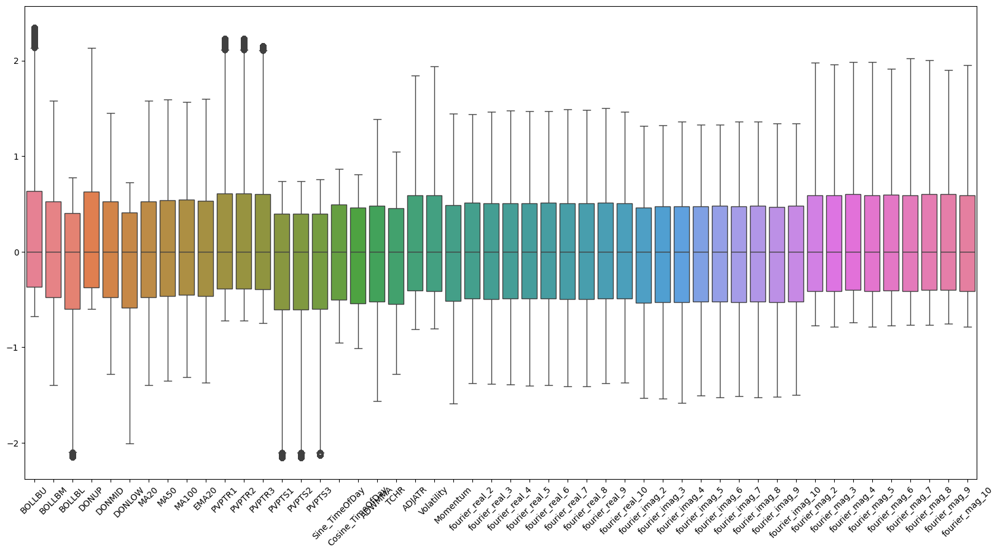

In [32]:
plt.figure(figsize=(20, 10))
sns.boxplot(data=trading_data_scaled[all_training_features])
plt.xticks(rotation=45)
plt.show()

#### UnderSampling and Oversampling Data

In [33]:
do_smote = False
if do_smote:
    epsilon = 0.05

    X = trading_data_scaled[all_training_features]
    y = trading_data_scaled['Close_Slope']

    # Balance dataset by reducing near zero slopes
    extreme_values = trading_data_scaled[np.abs(y) > epsilon]
    near_zero_values = trading_data_scaled[np.abs(y) <= epsilon].sample(frac=0.3, random_state=42)
    balanced_data = pd.concat([extreme_values, near_zero_values]).reset_index(drop=True)
    print(f"Balanced data before smogn shape: {balanced_data.shape}")
    balanced_data['Close_Slope'].describe()
    features_with_labels = all_training_features + ['Close_Slope']
    balanced_data = balanced_data[features_with_labels]

    # Apply SMOGN
    smote_balanced_data = smogn.smoter(
        data=balanced_data, 
        y='Close_Slope', 
        samp_method='balance'
    )
    print(f"Balanced data after smogn shape: {smote_balanced_data.shape}")
    #X_balanced = balanced_data[all_training_features]
    #y_balanced = balanced_data['Close_Slope']

    X = smote_balanced_data[all_training_features]
    y = smote_balanced_data['Close_Slope']

In [34]:
def weighted_loss(preds, dtrain):
    labels = dtrain.get_label()
    residuals = (preds - labels).astype("float")
    weights = np.where(np.abs(labels) > 0.05, 5.0, 1.0)
    grad = 2.0 * residuals * weights
    hess = 2.0 * weights
    return grad, hess

#### Check Weights of buy power and sell power

In [35]:
y = trading_data_scaled[['BuyPower', 'SellPower']]
X = trading_data_scaled[all_training_features]
buying_weight = (y['BuyPower'] > 0).sum() / (y['BuyPower'] == 0).sum()
selling_weight = (y['SellPower'] > 0).sum() / (y['SellPower'] == 0).sum()
print(f"Buying weight: {buying_weight}")
print(f"Selling weight: {selling_weight}")

Buying weight: 0.5632132324657008
Selling weight: 0.4699401666892737


In [36]:
((y['BuyPower'] == 0) & (y['SellPower'] == 0)).sum()

np.int64(31211)

In [37]:
do_weight_balancing = False
if do_weight_balancing:
    epsilon = 0.05
    extreme_values = trading_data_scaled[np.abs(trading_data_scaled['Close_Slope']) > epsilon]
    near_zero_values = trading_data_scaled[np.abs(trading_data_scaled['Close_Slope']) <= epsilon].sample(frac=0.5, random_state=42)
    print(f"Extreme values shape: {extreme_values.shape} and near zero values shape: {near_zero_values.shape}")
    balanced_data = pd.concat([extreme_values, near_zero_values]).reset_index(drop=True)
    print(f"Balanced data shape: {balanced_data.shape} and actual data shape : {trading_data_scaled.shape}")
    X = balanced_data[all_training_features]
    y = balanced_data['Close_Slope']

In [38]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=43)


In [39]:
print(X.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97532 entries, 0 to 97531
Data columns (total 50 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   BOLLBU            97532 non-null  float64
 1   BOLLBM            97532 non-null  float64
 2   BOLLBL            97532 non-null  float64
 3   DONUP             97532 non-null  float64
 4   DONMID            97532 non-null  float64
 5   DONLOW            97532 non-null  float64
 6   MA20              97532 non-null  float64
 7   MA50              97532 non-null  float64
 8   MA100             97532 non-null  float64
 9   EMA20             97532 non-null  float64
 10  PVPTR1            97532 non-null  float64
 11  PVPTR2            97532 non-null  float64
 12  PVPTR3            97532 non-null  float64
 13  PVPTS1            97532 non-null  float64
 14  PVPTS2            97532 non-null  float64
 15  PVPTS3            97532 non-null  float64
 16  Sine_TimeOfDay    97532 non-null  float6

In [40]:


#convert data to d matrix to use with xgb
enab_cat = False
dtrain = xgb.DMatrix(X_train, label=y_train, enable_categorical=False )
dtest = xgb.DMatrix(X_test, label=y_test, enable_categorical=False)

In [41]:
num_boosting_rounds = 20000
##### Implement initial training of the model   
learning_rate = 0.01
starting_tree_method = 'approx'
#metric can be mlogloss, auc, merror etc
metric = 'rmse'

base_params = {
    'objective': 'reg:squarederror',
    'eval_metric': metric,
    'scale_pos_weight': 2.0
}

params = {
    'tree_method': starting_tree_method
}

params.update(base_params)

In [42]:
#model = xgb.train(params=params, dtrain=dtrain, num_boost_round=num_boosting_rounds, evals=[(dtrain, 'train')], early_stopping_rounds=50)

In [43]:
##### CReate the objective function for optuna to tune tree parameters

def objective(trial):
    #print("Point 0")
    params = {
        'tree_method' : trial.suggest_categorical('tree_method', ['approx', 'hist']) , 
        'gamma': trial.suggest_float('gamma', 1e-2, 10),
        'max_depth': trial.suggest_int('max_depth', 3, 12),
        'eta': trial.suggest_float('eta', 0.001, 0.3, log=True),
        'min_child_weight': trial.suggest_float('min_child_weight', 1, 250),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'lambda': trial.suggest_float('lambda', 0.001, 25), 
        'alpha': trial.suggest_float('alpha', 0.001, 10)
    }
    #'scale_pos_weight': trial.suggest_float('scale_pos_weight', min(buying_weight, selling_weight), max(buying_weight, selling_weight))
    params.update(base_params)
    #thresholds = [trial.suggest_float(f'threshold_{i}', 0.1, 0.9) for i in ]
    pruning_callback = optuna.integration.XGBoostPruningCallback(trial, f'test-{metric}')
    evals_result = {}
    #print("Point 1")
    #print(dtrain)
    xgb_model = xgb.train(params=params, dtrain=dtrain, num_boost_round=num_boosting_rounds, 
                          evals=[(dtest, 'test')],
                          early_stopping_rounds=50,
                          verbose_eval=False,
                          callbacks=[pruning_callback],
                          evals_result=evals_result
                        )
    #print("Point 2")
    preds = xgb_model.predict(dtest)
    rmse_buy = mean_squared_error(y_test['BuyPower'], preds[:, 0]) ** 0.5
    rmse_sell = mean_squared_error(y_test['SellPower'], preds[:, 1]) ** 0.5
    #rmse = np.sqrt(np.mean((preds - y_test.values) ** 2))
    rmse = (rmse_buy + rmse_sell) / 2
    #print("Point 3")
    print(f"Trial {trial.number}: Best iteration = {xgb_model.best_iteration}, test rmse = {rmse}")

    return rmse

In [44]:

study = optuna.create_study(direction='minimize') # for metric auc its maximuze, and for mlogloss its minimie
study.optimize(objective, n_trials=100)

# Get the best parameters
print(f" Best parameters: {study.best_params}")
print(f" Best Accuracy: {study.best_value}")

[I 2025-03-05 14:18:26,742] A new study created in memory with name: no-name-7f69c79e-54db-47d7-946b-01c7e4ca5189
[I 2025-03-05 14:18:29,240] Trial 0 finished with value: 0.2947542253842417 and parameters: {'tree_method': 'hist', 'gamma': 6.79549307697992, 'max_depth': 9, 'eta': 0.027195955911718653, 'min_child_weight': 103.47716738442037, 'subsample': 0.32658340942129643, 'colsample_bytree': 0.6863954942138027, 'lambda': 14.160893157546159, 'alpha': 8.300015138407602}. Best is trial 0 with value: 0.2947542253842417.


Trial 0: Best iteration = 768, test rmse = 0.2947542253842417


[I 2025-03-05 14:18:30,792] Trial 1 finished with value: 0.2918135226146281 and parameters: {'tree_method': 'hist', 'gamma': 4.1477328021952475, 'max_depth': 7, 'eta': 0.013537053879606043, 'min_child_weight': 176.0696452820052, 'subsample': 0.9981791126989451, 'colsample_bytree': 0.6727795890656658, 'lambda': 24.16620825340882, 'alpha': 5.705335464610068}. Best is trial 1 with value: 0.2918135226146281.


Trial 1: Best iteration = 221, test rmse = 0.2918135226146281


[I 2025-03-05 14:18:37,750] Trial 2 finished with value: 0.29121610490732863 and parameters: {'tree_method': 'hist', 'gamma': 5.064234408105557, 'max_depth': 12, 'eta': 0.004695503415934377, 'min_child_weight': 4.635715057325678, 'subsample': 0.8149707357960148, 'colsample_bytree': 0.7435163820994256, 'lambda': 13.576273239766996, 'alpha': 5.902640108469618}. Best is trial 2 with value: 0.29121610490732863.


Trial 2: Best iteration = 1625, test rmse = 0.29121610490732863


[I 2025-03-05 14:18:38,579] Trial 3 finished with value: 0.29467564075554464 and parameters: {'tree_method': 'approx', 'gamma': 7.316940621455234, 'max_depth': 10, 'eta': 0.12992924056264465, 'min_child_weight': 129.44117160524718, 'subsample': 0.33681654384992127, 'colsample_bytree': 0.6857481233445953, 'lambda': 15.105515937095422, 'alpha': 4.124268418403151}. Best is trial 2 with value: 0.29121610490732863.


Trial 3: Best iteration = 192, test rmse = 0.29467564075554464


[I 2025-03-05 14:18:39,137] Trial 4 finished with value: 0.2929883875828464 and parameters: {'tree_method': 'approx', 'gamma': 5.348279933217672, 'max_depth': 11, 'eta': 0.13583809036459937, 'min_child_weight': 112.62802866644239, 'subsample': 0.8104169461898121, 'colsample_bytree': 0.6821613608725594, 'lambda': 17.5242148276266, 'alpha': 6.357576031378364}. Best is trial 2 with value: 0.29121610490732863.
[I 2025-03-05 14:18:39,204] Trial 5 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:39,258] Trial 6 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:39,317] Trial 7 pruned. Trial was pruned at iteration 0.


Trial 4: Best iteration = 101, test rmse = 0.2929883875828464


[I 2025-03-05 14:18:39,877] Trial 8 finished with value: 0.29188423863458957 and parameters: {'tree_method': 'approx', 'gamma': 3.8680852894158995, 'max_depth': 7, 'eta': 0.11024071819650111, 'min_child_weight': 220.39761051692383, 'subsample': 0.9492167808164426, 'colsample_bytree': 0.7409182948398971, 'lambda': 24.185438770411018, 'alpha': 5.653456641576021}. Best is trial 2 with value: 0.29121610490732863.
[I 2025-03-05 14:18:39,943] Trial 9 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:39,962] Trial 10 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:39,982] Trial 11 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:40,001] Trial 12 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:40,026] Trial 13 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:40,047] Trial 14 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:40,072] Trial 15 pruned. Trial was pruned at iteration 0.


Trial 8: Best iteration = 60, test rmse = 0.29188423863458957


[I 2025-03-05 14:18:40,094] Trial 16 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:40,121] Trial 17 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:41,120] Trial 18 pruned. Trial was pruned at iteration 242.
[I 2025-03-05 14:18:41,605] Trial 19 finished with value: 0.2918143370141153 and parameters: {'tree_method': 'hist', 'gamma': 5.907176696900225, 'max_depth': 5, 'eta': 0.2875651805058282, 'min_child_weight': 35.72397608837369, 'subsample': 0.7412392739325242, 'colsample_bytree': 0.8753791674006586, 'lambda': 4.427840688399465, 'alpha': 3.81482795060689}. Best is trial 2 with value: 0.29121610490732863.
[I 2025-03-05 14:18:41,626] Trial 20 pruned. Trial was pruned at iteration 0.


Trial 19: Best iteration = 80, test rmse = 0.2918143370141153


[I 2025-03-05 14:18:42,060] Trial 21 finished with value: 0.2928954393306905 and parameters: {'tree_method': 'hist', 'gamma': 5.986224521868238, 'max_depth': 5, 'eta': 0.2786804995056497, 'min_child_weight': 29.632594722265523, 'subsample': 0.715584068096959, 'colsample_bytree': 0.8815636978259493, 'lambda': 5.195905887780385, 'alpha': 4.065838383708791}. Best is trial 2 with value: 0.29121610490732863.


Trial 21: Best iteration = 80, test rmse = 0.2928954393306905


[I 2025-03-05 14:18:42,575] Trial 22 finished with value: 0.2890529051714388 and parameters: {'tree_method': 'hist', 'gamma': 3.4684884973042367, 'max_depth': 6, 'eta': 0.28579572047391544, 'min_child_weight': 3.8371465120207935, 'subsample': 0.7657587432385315, 'colsample_bytree': 0.7558612482256816, 'lambda': 6.9787107405789595, 'alpha': 6.3926508172299235}. Best is trial 22 with value: 0.2890529051714388.
[I 2025-03-05 14:18:42,602] Trial 23 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:42,630] Trial 24 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:42,649] Trial 25 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:42,734] Trial 26 pruned. Trial was pruned at iteration 0.


Trial 22: Best iteration = 101, test rmse = 0.2890529051714388


[I 2025-03-05 14:18:42,806] Trial 27 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:42,830] Trial 28 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:42,848] Trial 29 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:42,872] Trial 30 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:43,342] Trial 31 finished with value: 0.2920090268691551 and parameters: {'tree_method': 'hist', 'gamma': 5.893545578673003, 'max_depth': 5, 'eta': 0.28352529826796025, 'min_child_weight': 38.65739139350404, 'subsample': 0.7492731533274023, 'colsample_bytree': 0.8989990210830303, 'lambda': 5.245242733071043, 'alpha': 3.9874729478887545}. Best is trial 22 with value: 0.2890529051714388.
[I 2025-03-05 14:18:43,413] Trial 32 pruned. Trial was pruned at iteration 10.
[I 2025-03-05 14:18:43,434] Trial 33 pruned. Trial was pruned at iteration 0.


Trial 31: Best iteration = 94, test rmse = 0.2920090268691551


[I 2025-03-05 14:18:44,067] Trial 34 finished with value: 0.2912227019402854 and parameters: {'tree_method': 'approx', 'gamma': 4.381883839208334, 'max_depth': 6, 'eta': 0.17530493195973298, 'min_child_weight': 125.44468772346232, 'subsample': 0.7978950025392759, 'colsample_bytree': 0.9431886094254646, 'lambda': 0.24098151573159843, 'alpha': 4.386260545127772}. Best is trial 22 with value: 0.2890529051714388.


Trial 34: Best iteration = 101, test rmse = 0.2912227019402854


[I 2025-03-05 14:18:44,689] Trial 35 finished with value: 0.290572181837489 and parameters: {'tree_method': 'approx', 'gamma': 3.5411603199335286, 'max_depth': 6, 'eta': 0.1420250737389146, 'min_child_weight': 120.04814946748013, 'subsample': 0.8078153478230937, 'colsample_bytree': 0.9834814868135966, 'lambda': 0.2005434790320697, 'alpha': 6.377100476187148}. Best is trial 22 with value: 0.2890529051714388.


Trial 35: Best iteration = 98, test rmse = 0.290572181837489


[I 2025-03-05 14:18:45,535] Trial 36 finished with value: 0.29173660285540004 and parameters: {'tree_method': 'approx', 'gamma': 3.3637821202625053, 'max_depth': 6, 'eta': 0.17201021813437187, 'min_child_weight': 130.84223584600792, 'subsample': 0.4820827459199453, 'colsample_bytree': 0.9954107301253169, 'lambda': 0.5012797870787544, 'alpha': 6.016120813786607}. Best is trial 22 with value: 0.2890529051714388.
[I 2025-03-05 14:18:45,563] Trial 37 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:45,591] Trial 38 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:45,616] Trial 39 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:45,636] Trial 40 pruned. Trial was pruned at iteration 0.


Trial 36: Best iteration = 178, test rmse = 0.29173660285540004


[I 2025-03-05 14:18:45,807] Trial 41 pruned. Trial was pruned at iteration 26.
[I 2025-03-05 14:18:45,831] Trial 42 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:45,859] Trial 43 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:45,884] Trial 44 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:45,913] Trial 45 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:45,932] Trial 46 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:50,487] Trial 47 finished with value: 0.28258507968743396 and parameters: {'tree_method': 'approx', 'gamma': 1.0700549897480656, 'max_depth': 5, 'eta': 0.2214330396677999, 'min_child_weight': 64.852108559377, 'subsample': 0.5087027769368869, 'colsample_bytree': 0.9506009627377904, 'lambda': 2.432482079370255, 'alpha': 7.59779924549826}. Best is trial 47 with value: 0.28258507968743396.


Trial 47: Best iteration = 1186, test rmse = 0.28258507968743396


[I 2025-03-05 14:18:52,341] Trial 48 finished with value: 0.2869610544926906 and parameters: {'tree_method': 'approx', 'gamma': 1.2501862132993484, 'max_depth': 5, 'eta': 0.24434057707209708, 'min_child_weight': 57.1739358580284, 'subsample': 0.6099316029356796, 'colsample_bytree': 0.5607751877965462, 'lambda': 4.124479501417609, 'alpha': 7.67284694058185}. Best is trial 47 with value: 0.28258507968743396.


Trial 48: Best iteration = 457, test rmse = 0.2869610544926906


[I 2025-03-05 14:18:55,421] Trial 49 finished with value: 0.28589686398609615 and parameters: {'tree_method': 'approx', 'gamma': 1.1551464962406381, 'max_depth': 5, 'eta': 0.23140937644706608, 'min_child_weight': 17.907019299122748, 'subsample': 0.6055273688597231, 'colsample_bytree': 0.579999861297305, 'lambda': 4.2782430808583385, 'alpha': 9.9942090092116}. Best is trial 47 with value: 0.28258507968743396.
[I 2025-03-05 14:18:55,444] Trial 50 pruned. Trial was pruned at iteration 0.


Trial 49: Best iteration = 821, test rmse = 0.28589686398609615


[I 2025-03-05 14:18:56,503] Trial 51 pruned. Trial was pruned at iteration 271.
[I 2025-03-05 14:18:56,530] Trial 52 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:56,553] Trial 53 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:57,493] Trial 54 finished with value: 0.2894713004836408 and parameters: {'tree_method': 'approx', 'gamma': 2.131825029882048, 'max_depth': 5, 'eta': 0.29204326696843275, 'min_child_weight': 53.428421879584626, 'subsample': 0.6891750139240465, 'colsample_bytree': 0.6363214664892378, 'lambda': 4.474963517059106, 'alpha': 7.636118703469773}. Best is trial 47 with value: 0.28258507968743396.


Trial 54: Best iteration = 214, test rmse = 0.2894713004836408


[I 2025-03-05 14:18:58,008] Trial 55 finished with value: 0.2897224171114835 and parameters: {'tree_method': 'approx', 'gamma': 2.0006510507380404, 'max_depth': 5, 'eta': 0.2790790723503308, 'min_child_weight': 56.39486941397591, 'subsample': 0.6557786831377895, 'colsample_bytree': 0.5610123813264088, 'lambda': 4.4743637739166875, 'alpha': 7.493873741020393}. Best is trial 47 with value: 0.28258507968743396.
[I 2025-03-05 14:18:58,030] Trial 56 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:58,073] Trial 57 pruned. Trial was pruned at iteration 2.
[I 2025-03-05 14:18:58,099] Trial 58 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:58,138] Trial 59 pruned. Trial was pruned at iteration 2.
[I 2025-03-05 14:18:58,165] Trial 60 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:58,188] Trial 61 pruned. Trial was pruned at iteration 0.


Trial 55: Best iteration = 80, test rmse = 0.2897224171114835


[I 2025-03-05 14:18:59,176] Trial 62 pruned. Trial was pruned at iteration 271.
[I 2025-03-05 14:18:59,204] Trial 63 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:59,231] Trial 64 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:59,253] Trial 65 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:59,278] Trial 66 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:18:59,308] Trial 67 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:03,361] Trial 68 finished with value: 0.28501808979204535 and parameters: {'tree_method': 'approx', 'gamma': 0.9548492077790776, 'max_depth': 4, 'eta': 0.2995339850898897, 'min_child_weight': 19.796038401951225, 'subsample': 0.7278223136866963, 'colsample_bytree': 0.5563384580076834, 'lambda': 1.402605447951905, 'alpha': 8.111862212288258}. Best is trial 47 with value: 0.28258507968743396.
[I 2025-03-05 14:19:03,384] Trial 69 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:03,406] Trial 70 pr

Trial 68: Best iteration = 1126, test rmse = 0.28501808979204535


[I 2025-03-05 14:19:04,256] Trial 71 pruned. Trial was pruned at iteration 242.
[I 2025-03-05 14:19:04,281] Trial 72 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:04,306] Trial 73 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:15,626] Trial 74 finished with value: 0.26078686220548297 and parameters: {'tree_method': 'approx', 'gamma': 0.26365896719644133, 'max_depth': 4, 'eta': 0.2943981239460551, 'min_child_weight': 193.47628846037566, 'subsample': 0.7741527704249458, 'colsample_bytree': 0.5797345945431602, 'lambda': 3.576906820201314, 'alpha': 0.989556220100761}. Best is trial 74 with value: 0.26078686220548297.
[I 2025-03-05 14:19:15,650] Trial 75 pruned. Trial was pruned at iteration 0.


Trial 74: Best iteration = 2650, test rmse = 0.26078686220548297


[I 2025-03-05 14:19:18,235] Trial 76 finished with value: 0.2803780092650634 and parameters: {'tree_method': 'approx', 'gamma': 0.6907923796551547, 'max_depth': 4, 'eta': 0.2909440659902228, 'min_child_weight': 31.383387069473123, 'subsample': 0.6083814972047952, 'colsample_bytree': 0.7228082309023007, 'lambda': 3.35039108873816, 'alpha': 8.442127603984241}. Best is trial 74 with value: 0.26078686220548297.
[I 2025-03-05 14:19:18,264] Trial 77 pruned. Trial was pruned at iteration 1.
[I 2025-03-05 14:19:18,287] Trial 78 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:18,311] Trial 79 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:18,384] Trial 80 pruned. Trial was pruned at iteration 0.


Trial 76: Best iteration = 597, test rmse = 0.2803780092650634


[I 2025-03-05 14:19:18,482] Trial 81 pruned. Trial was pruned at iteration 3.
[I 2025-03-05 14:19:21,489] Trial 82 pruned. Trial was pruned at iteration 872.
[I 2025-03-05 14:19:21,513] Trial 83 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:21,535] Trial 84 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:24,807] Trial 85 finished with value: 0.27803625207233884 and parameters: {'tree_method': 'approx', 'gamma': 0.6017075843810662, 'max_depth': 5, 'eta': 0.25006249838260736, 'min_child_weight': 14.703168819654277, 'subsample': 0.5437712556325255, 'colsample_bytree': 0.5104416103275977, 'lambda': 5.225908052987785, 'alpha': 8.294400536547295}. Best is trial 74 with value: 0.26078686220548297.
[I 2025-03-05 14:19:24,838] Trial 86 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:24,898] Trial 87 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:24,979] Trial 88 pruned. Trial was pruned at iteration 0.


Trial 85: Best iteration = 698, test rmse = 0.27803625207233884


[I 2025-03-05 14:19:25,044] Trial 89 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:25,964] Trial 90 finished with value: 0.2829464603805705 and parameters: {'tree_method': 'approx', 'gamma': 1.7637734126116866, 'max_depth': 6, 'eta': 0.22776980597220944, 'min_child_weight': 17.370822855307978, 'subsample': 0.5422192589699332, 'colsample_bytree': 0.7310147149917685, 'lambda': 7.42543068998264, 'alpha': 0.48189507648784635}. Best is trial 74 with value: 0.26078686220548297.


Trial 90: Best iteration = 175, test rmse = 0.2829464603805705


[I 2025-03-05 14:19:27,873] Trial 91 finished with value: 0.27949680476864863 and parameters: {'tree_method': 'approx', 'gamma': 1.574063253953591, 'max_depth': 7, 'eta': 0.23031916348068585, 'min_child_weight': 16.142052403741992, 'subsample': 0.5300305893438496, 'colsample_bytree': 0.7541949891360128, 'lambda': 7.511558740874948, 'alpha': 0.54021237654254}. Best is trial 74 with value: 0.26078686220548297.


Trial 91: Best iteration = 455, test rmse = 0.27949680476864863


[I 2025-03-05 14:19:29,153] Trial 92 finished with value: 0.2813346246875465 and parameters: {'tree_method': 'approx', 'gamma': 1.7192542228877907, 'max_depth': 7, 'eta': 0.2213861889021982, 'min_child_weight': 15.504688213651782, 'subsample': 0.5130929996212986, 'colsample_bytree': 0.7364595535942847, 'lambda': 7.205336940877668, 'alpha': 0.7135343571787667}. Best is trial 74 with value: 0.26078686220548297.


Trial 92: Best iteration = 266, test rmse = 0.2813346246875465


[I 2025-03-05 14:19:33,626] Trial 93 pruned. Trial was pruned at iteration 1237.
[I 2025-03-05 14:19:33,650] Trial 94 pruned. Trial was pruned at iteration 0.
[I 2025-03-05 14:19:35,024] Trial 95 finished with value: 0.282060789966465 and parameters: {'tree_method': 'approx', 'gamma': 1.7263060840638573, 'max_depth': 7, 'eta': 0.2356086216327269, 'min_child_weight': 6.792078335468451, 'subsample': 0.4553967111859828, 'colsample_bytree': 0.7463049024875593, 'lambda': 8.74328317776732, 'alpha': 0.5409355476248381}. Best is trial 74 with value: 0.26078686220548297.


Trial 95: Best iteration = 290, test rmse = 0.282060789966465


[I 2025-03-05 14:19:45,720] Trial 96 finished with value: 0.2581694701073194 and parameters: {'tree_method': 'approx', 'gamma': 0.6068074309389502, 'max_depth': 7, 'eta': 0.16694497775140948, 'min_child_weight': 7.8113114315558985, 'subsample': 0.43562507821088414, 'colsample_bytree': 0.7858941922961643, 'lambda': 10.001427008986763, 'alpha': 0.41722041082407557}. Best is trial 96 with value: 0.2581694701073194.


Trial 96: Best iteration = 2501, test rmse = 0.2581694701073194


[I 2025-03-05 14:19:51,939] Trial 97 finished with value: 0.26010895641123105 and parameters: {'tree_method': 'approx', 'gamma': 0.6272141332681609, 'max_depth': 7, 'eta': 0.15709953717865785, 'min_child_weight': 6.6632175613194455, 'subsample': 0.42642341784948457, 'colsample_bytree': 0.7823879807834155, 'lambda': 9.737706647621636, 'alpha': 0.4916000439346162}. Best is trial 96 with value: 0.2581694701073194.


Trial 97: Best iteration = 1290, test rmse = 0.26010895641123105


[I 2025-03-05 14:19:59,676] Trial 98 finished with value: 0.25895891436678664 and parameters: {'tree_method': 'approx', 'gamma': 0.5944239736892769, 'max_depth': 7, 'eta': 0.1669496287703258, 'min_child_weight': 6.137080294903983, 'subsample': 0.4074494886744378, 'colsample_bytree': 0.763229252812526, 'lambda': 10.106140802192279, 'alpha': 0.47893626127650557}. Best is trial 96 with value: 0.2581694701073194.
[I 2025-03-05 14:19:59,721] Trial 99 pruned. Trial was pruned at iteration 0.


Trial 98: Best iteration = 1637, test rmse = 0.25895891436678664
 Best parameters: {'tree_method': 'approx', 'gamma': 0.6068074309389502, 'max_depth': 7, 'eta': 0.16694497775140948, 'min_child_weight': 7.8113114315558985, 'subsample': 0.43562507821088414, 'colsample_bytree': 0.7858941922961643, 'lambda': 10.001427008986763, 'alpha': 0.41722041082407557}
 Best Accuracy: 0.2581694701073194


In [45]:
best_params = study.best_params
#best_params
for trial in study.trials:
    print(f"Trial {trial.number}: Best iteration = {trial.user_attrs.get('best_iteration')}, best test rmse = {trial.value}")


Trial 0: Best iteration = None, best test rmse = 0.2947542253842417
Trial 1: Best iteration = None, best test rmse = 0.2918135226146281
Trial 2: Best iteration = None, best test rmse = 0.29121610490732863
Trial 3: Best iteration = None, best test rmse = 0.29467564075554464
Trial 4: Best iteration = None, best test rmse = 0.2929883875828464
Trial 5: Best iteration = None, best test rmse = 0.2994197269408814
Trial 6: Best iteration = None, best test rmse = 0.2994029160776824
Trial 7: Best iteration = None, best test rmse = 0.299449754996794
Trial 8: Best iteration = None, best test rmse = 0.29188423863458957
Trial 9: Best iteration = None, best test rmse = 0.2993219374697635
Trial 10: Best iteration = None, best test rmse = 0.29946968010508973
Trial 11: Best iteration = None, best test rmse = 0.2994326325307888
Trial 12: Best iteration = None, best test rmse = 0.2991347015362112
Trial 13: Best iteration = None, best test rmse = 0.29946192123628473
Trial 14: Best iteration = None, best te

In [46]:
low_learning_rate = 0.0326
num_boosting_rounds = 20000
params = {}
params.update(base_params)
params.update(study.best_params)
#params['learning_rate'] = low_learning_rate
params['scale_pos_weight']



2.0

In [47]:
model_stage2 = xgb.train(params=params, dtrain=dtrain, num_boost_round=num_boosting_rounds, 
                         evals=[(dtrain, 'train'), (dtest, 'test')], 
                         early_stopping_rounds=50,
                         verbose_eval=500
                )

[0]	train-rmse:0.29779	test-rmse:0.29649
[500]	train-rmse:0.22883	test-rmse:0.26153
[1000]	train-rmse:0.22568	test-rmse:0.26033
[1500]	train-rmse:0.22366	test-rmse:0.25939
[2000]	train-rmse:0.22263	test-rmse:0.25888
[2500]	train-rmse:0.22131	test-rmse:0.25822
[2551]	train-rmse:0.22127	test-rmse:0.25825


In [48]:
model_stage2.best_iteration # got the best iteration from stage 2 training

2501

In [49]:
def learning_rate_decay(epoch):
    return 0.1 * (0.99 ** epoch)

#### Set the num boosting 

In [50]:
num_boosting_rounds = model_stage2.best_iteration

In [51]:
import math

def cosine_decay(current_round, num_boost_round):
    initial_lr = 0.2  # Starting learning rate
    final_lr = 0.01  # Minimum learning rate
    return final_lr + (initial_lr - final_lr) * (1 + math.cos(math.pi * current_round / num_boost_round)) / 2


In [52]:
model_final = xgb.train(params=params, 
                        dtrain=dtrain,
                        num_boost_round = num_boosting_rounds,
                        evals=[(dtest, 'test')],
                        callbacks=[xgb.callback.LearningRateScheduler(lambda current_round: cosine_decay(current_round, num_boosting_rounds))],
                        verbose_eval=100)

[0]	test-rmse:0.29649
[100]	test-rmse:0.26687
[200]	test-rmse:0.26458
[300]	test-rmse:0.26319
[400]	test-rmse:0.26286
[500]	test-rmse:0.26227
[600]	test-rmse:0.26190
[700]	test-rmse:0.26162
[800]	test-rmse:0.26139
[900]	test-rmse:0.26106
[1000]	test-rmse:0.26091
[1100]	test-rmse:0.26074
[1200]	test-rmse:0.26067
[1300]	test-rmse:0.26058
[1400]	test-rmse:0.26045
[1500]	test-rmse:0.26042
[1600]	test-rmse:0.26037
[1700]	test-rmse:0.26035
[1800]	test-rmse:0.26028
[1900]	test-rmse:0.26025
[2000]	test-rmse:0.26024
[2100]	test-rmse:0.26022
[2200]	test-rmse:0.26020
[2300]	test-rmse:0.26018
[2400]	test-rmse:0.26016
[2500]	test-rmse:0.26014


In [53]:
#model_path = f'../{config['model_save_name']}'
#model_final.save_model(model_path)

In [54]:
new_data_start_date = pd.to_datetime('2024-01-01')
new_data_end_date = pd.to_datetime('2024-03-30')
new_data = all_trading_data[(all_trading_data['Date'] >= new_data_start_date) & (all_trading_data['Date'] <= new_data_end_date)]
new_data = new_data.reset_index(drop=True)

In [55]:
new_data.shape

(24180, 7)

In [56]:
bolband_period = config['bolband_period']
donchn_period = config['donchn_period']
max_MA_period = 100
max_EMA_period = 20
tchr_period = config['tchr_period']
adwm_period = config['adwm_period']
atr_period = config['atr_period']
volume_ma_period = config['volume_ma_period']
print(f" Fourier window : {fourier_lookback_window}")
max_window = max(bolband_period, 
                 donchn_period, 
                 max_MA_period, 
                 max_EMA_period,
                 tchr_period,
                 adwm_period,
                 atr_period,
                 volume_ma_period, fourier_lookback_window)
print(f"Max window : {max_window}")


 Fourier window : 100
Max window : 100


In [57]:
def process_data(raw_data, scaler):

    trading_signals = pd.DataFrame(columns=['Date','High', 'Low', 'Open', 'Close', 'BuyPower', 'SellPower', 'Signal', 'Take_Profit_Level'])                   
    # This is the dataframe to which we will be adding the rows live
    historical_data = pd.DataFrame(columns=['Date','High', 'Low', 'Open', 'Close', 'Volume'])
    numeric_columns = ['High', 'Low', 'Open', 'Close', 'Volume'] 
    historical_data[numeric_columns] = historical_data[numeric_columns].apply(pd.to_numeric)
    all_training_features = get_all_training_features()
    predictions = []
    for index,row in raw_data.iterrows():

        if index % 100 == 0:
            logging.info(f'Index : {index}')
        new_row = pd.DataFrame({'Date': [row['Date']], 'High': [row['High']], 'Low': [row['Low']], 'Open': [row['Open']], 'Close': [row['Close']], 'Volume': [row['Volume']]})
        signal_row = pd.DataFrame({'Date': [row['Date']], 'High': [row['High']], 'Low': [row['Low']], 'Open': [row['Open']], 'Close': [row['Close']], 'Signal': ['N']})
        trading_signals = pd.concat([trading_signals, signal_row], ignore_index=True)
        historical_data = pd.concat([historical_data, new_row], ignore_index=True)
        historical_data['Volume'] = historical_data['Volume'].astype(int)
        #if len(historical_data) > max_window:
        #    historical_data = historical_data.iloc[-max_window:].reset_index(drop=True)
        if len(historical_data) > max_window:
            #print("Hist data length : ", len(historical_data))
            updated_data = add_new_features_df(historical_data)
            historical_data = historical_data.iloc[-max_window:].reset_index(drop=True)
            #print("Updated data length : ", len(updated_data))
            data_transformed = transform_features(updated_data)
            #print("Data transformed length : ", len(data_transformed))
            #data_transformed = data_transformed.dropna() 
            #data_transformed.reset_index(drop=True, inplace=True)
            inf_features = data_transformed.iloc[-max_window:].reset_index(drop=True)
            #print(f"inf_features shape : {inf_features.shape} and training features : {training_features_upd}")
            #print(inf_features.tail())
            inf_features[all_training_features] = scaler.transform(inf_features[all_training_features])
            last_row_features = inf_features.iloc[[-1]]
            last_row_features = last_row_features[all_training_features]
            if last_row_features.isna().any().any():
                print(f'The inference row at index : {index} contains na')
                print(historical_data[['Volume']].tail())
                break
                continue
        
            last_row_dm = xgb.DMatrix(last_row_features)
            prediction = model_final.predict(last_row_dm)
 
            buy_power, sell_power = prediction[0]
            trading_signals.loc[trading_signals.index[-1], 'BuyPower'] = buy_power
            trading_signals.loc[trading_signals.index[-1], 'SellPower'] = sell_power
            trading_signals.loc[trading_signals.index[-1], 'Take_Profit_Level'] = updated_data['Take_Profit_Level'].iloc[-1]
        
    return trading_signals
    

In [58]:
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

In [59]:
tr_signals = process_data(new_data, rscaler)

In [114]:
def calculate_trade(trading_signals, trade_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trade_params['fixed_profit_value']
    trade_enter_buy = trade_params['trade_enter']
    trade_enter_sell = trade_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trade_params['barNo_before_EOD']
    #min_bar_enter_trade_before_EOD = trade_params['min_bar_enter_trade_before_EOD']
    min_bar_enter_trade_before_EOD = 60
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    partial_profit_total = 0
    partial_loss_total = 0
    buy_count = 0
    sell_count = 0
    min_trade_distance = 300
    last_trade_exit = None
    total_trade_length = 0
    #risk = config['risk']
    risk = trade_params['risk']
    loss_amount = profit_amount * risk
    positions = pd.DataFrame(columns=['Entry', 'EntryDate', 'Exit', 'ExitDate', 'Profit', 'Type'])
                    
    for index,row in trading_signals.iterrows():
        buy_power = row['BuyPower']
        sell_power = row['SellPower']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
            if last_trade_exit == None or  (row['Date'] - last_trade_exit) > timedelta(seconds=min_trade_distance):
                if row['Date'] <= latest_trade_enter_time: 
                    if buy_power > sell_power and buy_power > trade_enter_buy:
                        if fixed_profit:
                            take_profit = fixed_profit_value
                        else:
                            take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "B", 
                                    "TakeProfit": row['Close'] + take_profit,
                                    "StopLoss": row['Close'] - (take_profit * config['risk']),
                                    "Profit": take_profit,
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        buy_count += 1
                    elif sell_power > buy_power and sell_power > trade_enter_sell:
                        take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "S", 
                                    "TakeProfit": row['Close'] - take_profit,
                                    "Profit": take_profit,
                                    "StopLoss": row['Close'] + (take_profit * config['risk']),
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        sell_count += 1
        else:
            trade = trades[0]
            
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1

                    print(f"EOD Exit, Profit, New Balance : {balance}")
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time
            else:
                trade_length = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                if buy_power > sell_power and buy_power > trade_enter_buy and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        partial_loss_total += abs(profit / profit_amount)
                        print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        partial_profit_total += (profit / profit_amount)
                        print(f"Partial Profit, New Balance : {balance}")
                    pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                    positions = pd.concat([positions, pos_row], ignore_index=True)
                    last_trade_exit = row['Date']
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                    total_trade_length += trade_time

                elif sell_power > buy_power and sell_power > trade_enter_sell and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        partial_loss_total += abs(profit / profit_amount)
                        print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        partial_profit_total += (profit / profit_amount)
                        print(f"Partial Profit, New Balance : {balance}")
                    pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                    positions = pd.concat([positions, pos_row], ignore_index=True)
                    last_trade_exit = row['Date']
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                    total_trade_length += trade_time
        
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                print(f"Take Profit, New Balance : {balance}")             
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': (trade['Profit'] * profit_amount), 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                print(f"Stop Loss, New Balance : {balance}")
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': (trade['Profit'] * -loss_amount), 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
        
    print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    print(f"Buy count : {buy_count} \n Sell count : {sell_count}")
    total_trade_count = buy_count + sell_count
    print(f"Average trade length in bars : {total_trade_length / total_trade_count}")
    print(f"Partial Profit Average : {partial_profit_total / partial_profit_count} \n Partial Loss Average : {partial_loss_total / partial_loss_count}")
    
    return positions


In [115]:
trade_params = {
    'fixed_profit_value': 2.0,
    'trade_enter': 0.4,
    'barNo_before_EOD': 20,
    'min_bar_enter_trade_before_EOD': 180,
    'risk': 0.16
}
positions_df = calculate_trade(tr_signals, trading_params_tuned)
#tr_signals.tail()

Partial Loss, New Balance : -0.3999999999996362
Take Profit, New Balance : 4.7485511850486635
Partial Loss, New Balance : 3.2985511850488454
Partial Loss, New Balance : 1.6485511850486407
Partial Profit, New Balance : 2.848551185048686
Partial Profit, New Balance : 4.148551185048641
Partial Profit, New Balance : 5.623551185048436
Partial Profit, New Balance : 6.223551185048459
Stop Loss, New Balance : 5.703368732898566
Partial Profit, New Balance : 7.003368732898521
Partial Profit, New Balance : 7.07936873289877
Partial Profit, New Balance : 16.680368732898884
Stop Loss, New Balance : 16.16018628074899
Partial Loss, New Balance : 14.962186280749012
Partial Profit, New Balance : 17.362186280748535
Take Profit, New Balance : 22.510737465796836
Partial Profit, New Balance : 29.010737465797177
Partial Profit, New Balance : 29.560737465797246
Stop Loss, New Balance : 29.040555013647353
Stop Loss, New Balance : 28.52037256149746
Partial Loss, New Balance : 27.1653725614971
Partial Profit, Ne

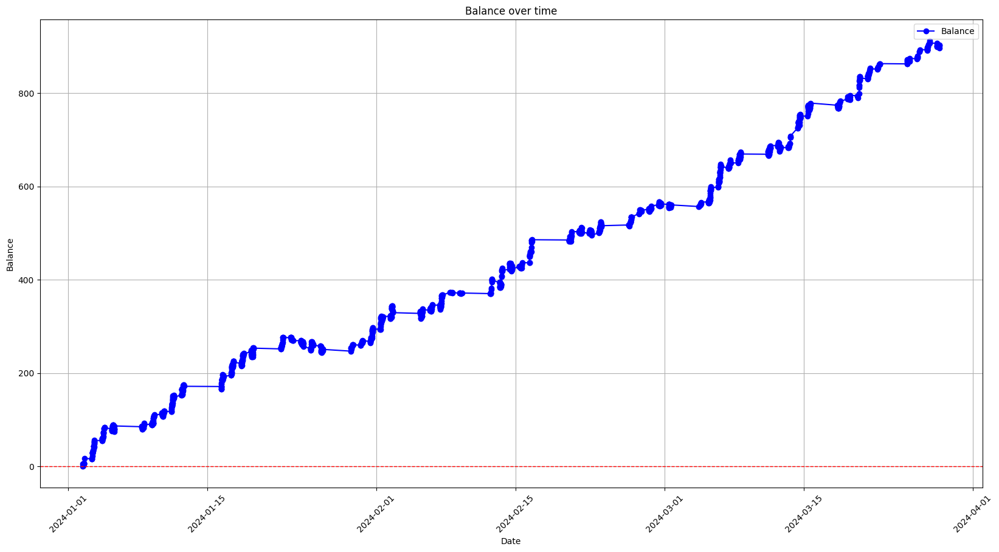

In [107]:
positions_df['ExitDate'] = pd.to_datetime(positions_df['ExitDate'])
positions_df = positions_df.sort_values(by='ExitDate')
positions_df['Balance'] = positions_df['Profit'].cumsum()

plt.figure(figsize=(20, 10))
plt.plot(positions_df['ExitDate'], positions_df['Balance'], marker='o', linestyle='-', color='b', label='Balance')
plt.xlabel('Date')
plt.ylabel('Balance')
plt.title('Balance over time')
plt.axhline(y=0, color='r', linestyle='--', linewidth=1)
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

In [98]:
def calculate_trade_optuna(trading_signals, trading_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trading_params['fixed_profit_value']
    trade_enter_buy = trading_params['trade_enter']
    trade_enter_sell = trading_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trading_params['barNo_before_EOD']
    min_bar_enter_trade_before_EOD = trading_params['min_bar_enter_trade_before_EOD']
    risk = trading_params['risk']
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    buy_count = 0
    sell_count = 0
    loss_amount = profit_amount * risk
    last_trade_exit = None
    min_trade_distance = 300

                    
    for index,row in trading_signals.iterrows():
        buy_power = row['BuyPower']
        sell_power = row['SellPower']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            if last_trade_exit == None or  (row['Date'] - last_trade_exit) > timedelta(seconds=min_trade_distance):
                eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
                latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
                
                if row['Date'] <= latest_trade_enter_time: 
                    if buy_power > sell_power and buy_power > trade_enter_buy:
                        if fixed_profit:
                            take_profit = fixed_profit_value
                        else:
                            take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "B", 
                                    "TakeProfit": row['Close'] + take_profit,
                                    "StopLoss": row['Close'] - (take_profit * config['risk']),
                                    "Profit": take_profit,
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        buy_count += 1
                    elif sell_power > buy_power and sell_power > trade_enter_sell:
                        take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "S", 
                                    "TakeProfit": row['Close'] - take_profit,
                                    "Profit": take_profit,
                                    "StopLoss": row['Close'] + (take_profit * config['risk']),
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        sell_count += 1
        else:
            trade = trades[0]
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    #print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1
                    #print(f"EOD Exit, Profit, New Balance : {balance}")
                last_trade_exit = row['Date']
            else:
                if buy_power > sell_power and buy_power > trade_enter_buy and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    last_trade_exit = row['Date']

                elif sell_power > buy_power and sell_power > trade_enter_sell and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    last_trade_exit = row['Date']
        
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                last_trade_exit = row['Date']
                #print(f"Take Profit, New Balance : {balance}")             
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                last_trade_exit = row['Date']
                #print(f"Stop Loss, New Balance : {balance}")


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
    return balance    
    #print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    #print(f"Buy count : {buy_count} \n Sell count : {sell_count}")

In [116]:
def trading_objective(trial):
    params = {
        'trade_enter': trial.suggest_float('trade_enter', 0.3, 2.0),
        'fixed_profit_value': trial.suggest_float('fixed_profit_value', 0.4, 4.0),
        'barNo_before_EOD': trial.suggest_int('barNo_before_EOD', 1, 30),
        'min_bar_enter_trade_before_EOD': trial.suggest_int('min_bar_enter_trade_before_EOD', 5, 30),
        'risk': trial.suggest_float('risk', 0.1, 2.0)
    }

    balance = calculate_trade_optuna(tr_signals, params)

    return balance

In [117]:
trading_study = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
trading_study.optimize(trading_objective, n_trials=200)

[I 2025-03-05 16:16:01,617] A new study created in memory with name: no-name-81993938-1611-4e59-9014-ec2f8d6f0e96
[I 2025-03-05 16:16:02,281] Trial 0 finished with value: -189.57382455835045 and parameters: {'trade_enter': 0.8552395087298419, 'fixed_profit_value': 1.4312603588442006, 'barNo_before_EOD': 23, 'min_bar_enter_trade_before_EOD': 19, 'risk': 1.03938331749996}. Best is trial 0 with value: -189.57382455835045.
[I 2025-03-05 16:16:02,817] Trial 1 finished with value: -126.10400193642336 and parameters: {'trade_enter': 1.310061189953398, 'fixed_profit_value': 1.4595587602516473, 'barNo_before_EOD': 7, 'min_bar_enter_trade_before_EOD': 9, 'risk': 1.4506755048723845}. Best is trial 1 with value: -126.10400193642336.
[I 2025-03-05 16:16:03,332] Trial 2 finished with value: -134.6799271656511 and parameters: {'trade_enter': 1.4198620664734223, 'fixed_profit_value': 0.6566135506819897, 'barNo_before_EOD': 9, 'min_bar_enter_trade_before_EOD': 6, 'risk': 1.8619638321200547}. Best is tr

In [119]:
print(trading_study.best_params)
trading_params_tuned = trading_study.best_params

{'trade_enter': 1.8379569277805503, 'fixed_profit_value': 2.5065575765591293, 'barNo_before_EOD': 25, 'min_bar_enter_trade_before_EOD': 17, 'risk': 1.8818377732556189}


In [118]:
trading_study.best_value

0.0

In [70]:
def calculate_trade_optuna_2values(trading_signals, trading_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trading_params['fixed_profit_value']
    trade_enter_buy = trading_params['trade_enter']
    trade_enter_sell = trading_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trading_params['barNo_before_EOD']
    min_bar_enter_trade_before_EOD = trading_params['min_bar_enter_trade_before_EOD']
    risk = trading_params['risk']
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    buy_count = 0
    sell_count = 0
    loss_amount = profit_amount * risk
    total_trade_length = 0
                    
    for index,row in trading_signals.iterrows():
        buy_power = row['BuyPower']
        sell_power = row['SellPower']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
            if row['Date'] <= latest_trade_enter_time: 
                if buy_power > sell_power and buy_power > trade_enter_buy:
                    if fixed_profit:
                        take_profit = fixed_profit_value
                    else:
                        take_profit = row['Take_Profit_Level'] 
                    trades.append({"Type": "B", 
                                "TakeProfit": row['Close'] + take_profit,
                                "StopLoss": row['Close'] - (take_profit * config['risk']),
                                "Profit": take_profit,
                                "Active": "Y",
                                'Entry': row['Close'],
                                'EntryDate': row['Date']
                                })
            
                    buy_count += 1
                elif sell_power > buy_power and sell_power > trade_enter_sell:
                    take_profit = row['Take_Profit_Level'] 
                    trades.append({"Type": "S", 
                                "TakeProfit": row['Close'] - take_profit,
                                "Profit": take_profit,
                                "StopLoss": row['Close'] + (take_profit * config['risk']),
                                "Active": "Y",
                                'Entry': row['Close'],
                                'EntryDate': row['Date']
                                })
                    sell_count += 1
        else:
            trade = trades[0]
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    #print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1
                    #print(f"EOD Exit, Profit, New Balance : {balance}")
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time
            else:
                if buy_power > sell_power and buy_power > trade_enter_buy and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")

                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                    total_trade_length += trade_time

                elif sell_power > buy_power and sell_power > trade_enter_sell and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                    total_trade_length += trade_time
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                #print(f"Take Profit, New Balance : {balance}")  
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time           
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                #print(f"Stop Loss, New Balance : {balance}")
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
    total_trade_count = buy_count + sell_count
    total_loss_count = loss_count + partial_loss_count
    return balance, total_trade_length / total_trade_count   
    #print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    #print(f"Buy count : {buy_count} \n Sell count : {sell_count}")

In [73]:
def trading_objective_2(trial):
    params = {
        'trade_enter': trial.suggest_float('trade_enter', 0.2, 2.0),
        'fixed_profit_value': trial.suggest_float('fixed_profit_value', 0.4, 4.0),
        'barNo_before_EOD': trial.suggest_int('barNo_before_EOD', 1, 30),
        'min_bar_enter_trade_before_EOD': trial.suggest_int('min_bar_enter_trade_before_EOD', 5, 30),
        'risk': trial.suggest_float('risk', 0.1, 2.0)
    }

    balance, trade_length = calculate_trade_optuna_2values(tr_signals, params)

    return balance, trade_length

In [74]:
trading_study_2 = optuna.create_study(directions=['maximize', 'minimize']) # for metric auc its maximuze, and for mlogloss its minimie
trading_study_2.optimize(trading_objective_2, n_trials=200)

[I 2025-03-05 14:59:22,903] A new study created in memory with name: no-name-564c1303-d542-4fb9-9ea9-89d3a91dbce6
[I 2025-03-05 14:59:23,417] Trial 0 finished with values: [-398.6217133022649, 11.57857142857143] and parameters: {'trade_enter': 0.5009757874887094, 'fixed_profit_value': 2.508780983135823, 'barNo_before_EOD': 18, 'min_bar_enter_trade_before_EOD': 22, 'risk': 0.9980491836385932}.
[I 2025-03-05 14:59:23,908] Trial 1 finished with values: [-177.53152980149864, 8.119205298013245] and parameters: {'trade_enter': 0.5097916002952668, 'fixed_profit_value': 1.1483498634951403, 'barNo_before_EOD': 13, 'min_bar_enter_trade_before_EOD': 25, 'risk': 0.6786257450834839}.
[I 2025-03-05 14:59:24,420] Trial 2 finished with values: [-1686.7506082165273, 6.884146341463414] and parameters: {'trade_enter': 0.3519562960135584, 'fixed_profit_value': 1.7400696189856424, 'barNo_before_EOD': 4, 'min_bar_enter_trade_before_EOD': 27, 'risk': 1.5654435364427866}.
[I 2025-03-05 14:59:24,916] Trial 3 f

In [75]:
sorted_trials = sorted(trading_study_2.best_trials, key=lambda t: t.values[0], reverse=True)
for trial in sorted_trials:
    print(f"Trial number : {trial.number}, Balance : {trial.values[0]}, Trade Length : {trial.values[1]}")

Trial number : 55, Balance : 831.2336781920219, Trade Length : 2.416065911431514
Trial number : 153, Balance : 831.2336781920219, Trade Length : 2.416065911431514
Trial number : 171, Balance : -680.7393217869685, Trade Length : 2.27705112960761
Trial number : 101, Balance : -1081.700902017323, Trade Length : 1.937888198757764


In [76]:
sorted_trials[0].params

{'trade_enter': 0.2415991569198071,
 'fixed_profit_value': 0.7241734557069652,
 'barNo_before_EOD': 7,
 'min_bar_enter_trade_before_EOD': 6,
 'risk': 0.11947859821788873}

In [ ]:
for trial in trading_study_2.trials:
    print(f"Trial {trial.number}: Best value = {trial.values}")

Trial 0: Best value = [420.80199689188004, 263.0]
Trial 1: Best value = [-49.93553682101156, 3.0]
Trial 2: Best value = [-3.7528638737576046, 290.0]
Trial 3: Best value = [132.07973992854397, 85.0]
Trial 4: Best value = [5.487857695356613, 133.0]
Trial 5: Best value = [92.4904572949738, 24.0]
Trial 6: Best value = [-9.453323356199078, 9.0]
Trial 7: Best value = [-233.67029260752417, 232.0]
Trial 8: Best value = [87.99203310314907, 97.0]
Trial 9: Best value = [-247.3006446033359, 189.0]
Trial 10: Best value = [99.58457331213921, 151.0]
Trial 11: Best value = [869.1926460884704, 599.0]
Trial 12: Best value = [164.44383489905508, 203.0]
Trial 13: Best value = [267.63740176036555, 183.0]
Trial 14: Best value = [-180.32554504400116, 158.0]
Trial 15: Best value = [35.414034673272425, 112.0]
Trial 16: Best value = [-599.0375067879481, 556.0]
Trial 17: Best value = [-30.23947556616759, 67.0]
Trial 18: Best value = [-322.7453503622835, 424.0]
Trial 19: Best value = [-39.54070262477896, 6.0]
Tri

In [108]:
def compute_trade_signal(row):
    trade_enter_buy = 0.5
    trade_enter_sell = 0.5
    if row['BuyPower'] > trade_enter_buy and row['BuyPower'] > row['SellPower']:
        return 'B'
    elif row['SellPower'] > trade_enter_sell and row['SellPower'] > row['BuyPower']:
        return 'S'
    else:
        return 'N'
    
tr_signals['SignalNew'] = tr_signals.apply(compute_trade_signal, axis=1)

In [99]:
buy_signals = tr_signals[tr_signals['Signal'] == 'B']
sell_signals = tr_signals[tr_signals['Signal']== 'S']
trade_to_show = '2024-01-05'
#trading_data['Date'] = pd.to_datetime(trading_data['Date'])
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                    row_heights=[0.7, 0.3], vertical_spacing=0.1,
                    subplot_titles=("CandleStick Chart", "Buy/Sell Signals"))
fig.add_trace(
    go.Candlestick(
        x=tr_signals['Date'], 
        open=tr_signals['Open'], 
        high=tr_signals['High'], 
        low=tr_signals['Low'], 
        close=tr_signals['Close'],
        name='OHLC'
        ), row=1, col=1
)
'''
fig.add_trace(
    go.Scatter(
        x=buy_signals['Date'], 
        y=buy_signals['Low'], 
        mode='markers', 
        name='Buy Signal', 
        marker=dict(color='blue', size=10)))

fig.add_trace(
    go.Scatter(
        x=sell_signals['Date'], 
        y=sell_signals['High'], 
        mode='markers', 
        name='Sell Signal', 
        marker=dict(color='yellow', size=10)))
'''
for index, row in positions_df.iterrows():
    if row['Type'] == 'B':
        entry_symbol = 'triangle-up'
        entry_color = 'blue'
        exit_symbol = 'triangle-down'
        exit_color ='green' if row['Profit'] >= 0 else 'red'
    elif row['Type'] == 'S':
        entry_symbol = 'triangle-down'
        entry_color = 'yellow'
        exit_symbol = 'triangle-up'
        exit_color = 'green' if row['Profit'] >= 0 else 'red'
    
    fig.add_trace(
        go.Scatter(
            x=[row['EntryDate']],
            y=[row['Entry'] + 0.1],
            mode='markers',
            marker=dict(symbol=entry_symbol, size=10, color=entry_color),
            name=f'Entry {row['Type']}'
        ))
    
    fig.add_trace(
        go.Scatter(
            x=[row['ExitDate']],
            y=[row['Exit'] - 0.1],
            mode='markers',
            marker=dict(symbol=exit_symbol, size=10, color=exit_color),
            name=f'Exit {row["Type"]}'
        ))
  
fig.add_trace(
    go.Scatter(
        x=tr_signals['Date'],
        y=tr_signals['BuyPower'],
        mode='lines',
        name='Buy Signal',
        line=dict(color='green', width=2)
    ), row=2, col=1
)

fig.add_trace(
    go.Scatter(
        x=tr_signals['Date'],
        y=tr_signals['SellPower'],
        mode='lines',
        name='Sell Signal',
        line=dict(color='red', width=2)
    ), row=2, col=1
)
  

fig.update_layout(
    title='CandleStick chart with Buy Sell Signals',
    xaxis=dict(type="date", 
               rangebreaks=[
                   dict(bounds=["sat", "mon"]),
                   dict(bounds=[16,9.5], pattern='hour')
               ]              
            ),
    xaxis_rangeslider_visible=False,
    height=600,
    hovermode='x unified'
)



fig.update_xaxes(matches='x')

fig.show()